<a href="https://colab.research.google.com/github/leonatopl/dataxgurupl/blob/master/CNN_New_NoIdl.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Import Libraries and required classes and Methods from Idlman

In [ ]:
# TEAM RL
# This code is written to import the packages and tqdm notebook.
# This includes tqdm, numpy, seaborn, matplotlib, pandas and time.


from tqdm.autonotebook import tqdm

import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt

import pandas as pd

import time

<ipython-input-1-c71ebd8d1bbc>:6: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


In [ ]:
#TEAM RL
#This code imports the relevant torch packages

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import *
# from idlmam import *

In [ ]:
#TEAM RL
# This code is written to import the packages and tqdm notebook.
# This includes tqdm, numpy, seaborn, matplotlib, pandas and time.
# This code imports pytorch.

import torch
import torch.nn as nn
import torch.nn.functional as F

from torch.utils.data import Dataset, DataLoader

from tqdm.autonotebook import tqdm


import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import pandas as pd

import time

from idlmam import train_simple_network, Flatten, weight_reset, set_seed, run_epoch, train_network

## Load data and data Exploration

In [ ]:
#TEAM RL
# mount the driver to be able to load data

from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#TEAM RL Load the data.
#load the Recession index with values only data first date of the Q

data = pd.read_csv("/content/drive/MyDrive/Project_5550/data_reduced_cleaned.csv")

In [ ]:
#TEAM RL
#This code shows the headers to insure we have the right data

data.head()

,date,X2Yr,X30Yr,X2yr.10yr,Unemployment,GDP,X3MUnemployment,X6M1Mo,X6M5Yr,X6M30Yr,...,X24MCPI,X24MM2,X36M1Yr,X36M7Yr,X36M30Yr,X36M2yr.10yr,X36MUnemployment,X36MSoftDev,X36MM2,Y
0,1997-01-26,1.94,0.0,2.44,5.2,0.0,4.9,0.88,3.36,0.0,...,164.7,4425.3,1.31,3.9,0.0,-2.44,4.1,99.595302,4679.4,2
1,1997-01-27,1.94,0.0,-2.44,5.2,0.0,4.9,0.88,3.36,0.0,...,164.7,4425.3,1.31,3.9,0.0,-2.44,4.1,99.595302,4679.4,2
2,1997-01-28,1.94,0.0,-2.44,5.2,0.0,4.9,0.88,3.36,0.0,...,164.7,4425.3,1.31,3.9,0.0,-2.44,4.1,99.595302,4679.4,2
3,1997-01-29,1.94,0.0,-2.44,5.2,0.0,4.9,0.88,3.36,0.0,...,164.7,4425.3,1.31,3.9,0.0,-2.44,4.1,99.595302,4679.4,2
4,1997-01-30,1.94,0.0,-2.44,5.2,0.0,4.9,0.88,3.36,0.0,...,164.7,4425.3,1.31,3.9,0.0,-2.44,4.1,99.595302,4679.4,2


In [ ]:
#TEAM RL
#This code converts the date field into a datetime
data["date"] = pd.to_datetime(data["date"])


In [ ]:
#TEAM RL
#This code displays the data types
data.dtypes

array([<Axes: xlabel='date'>, <Axes: xlabel='date'>,
       <Axes: xlabel='date'>, <Axes: xlabel='date'>,
       <Axes: xlabel='date'>, <Axes: xlabel='date'>,
       <Axes: xlabel='date'>, <Axes: xlabel='date'>,
       <Axes: xlabel='date'>, <Axes: xlabel='date'>], dtype=object)

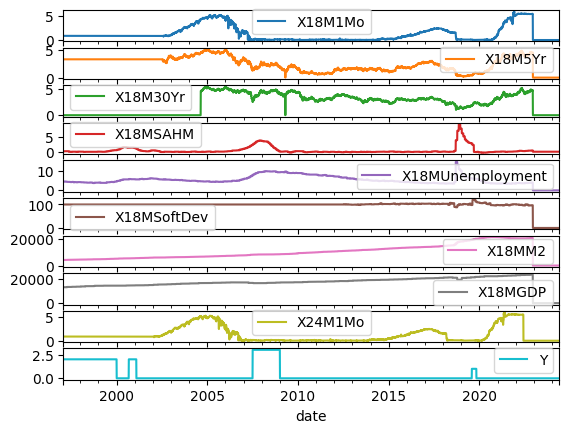

In [ ]:
#TEAM RL
#This code displays graphs for the second 10 variables and the Y variable
data.set_index('date')[['X18M1Mo', 'X18M5Yr', 'X18M30Yr', 'X18MSAHM', 'X18MUnemployment', 'X18MSoftDev', 'X18MM2', 'X18MGDP', 'X24M1Mo', 'Y']].plot(subplots=True)

array([<Axes: xlabel='date'>, <Axes: xlabel='date'>,
       <Axes: xlabel='date'>, <Axes: xlabel='date'>,
       <Axes: xlabel='date'>, <Axes: xlabel='date'>,
       <Axes: xlabel='date'>, <Axes: xlabel='date'>,
       <Axes: xlabel='date'>, <Axes: xlabel='date'>], dtype=object)

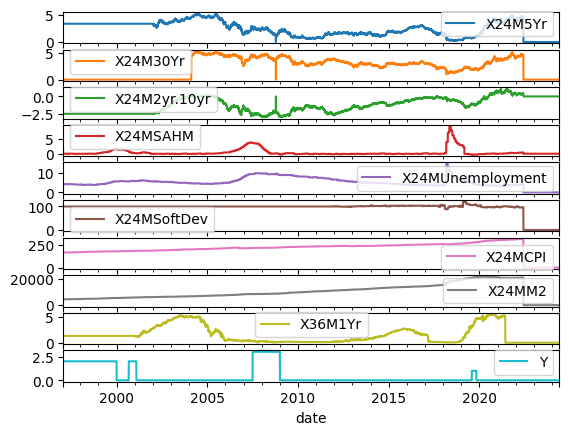

In [ ]:
##TEAM RL
#This code displays graphs for the third 10 variables and the Y variable
data.set_index('date')[['X24M5Yr', 'X24M30Yr', 'X24M2yr.10yr', 'X24MSAHM', 'X24MUnemployment', 'X24MSoftDev', 'X24MCPI', 'X24MM2', 'X36M1Yr', 'Y']].plot(subplots=True)

array([<Axes: xlabel='date'>, <Axes: xlabel='date'>,
       <Axes: xlabel='date'>, <Axes: xlabel='date'>,
       <Axes: xlabel='date'>, <Axes: xlabel='date'>,
       <Axes: xlabel='date'>], dtype=object)

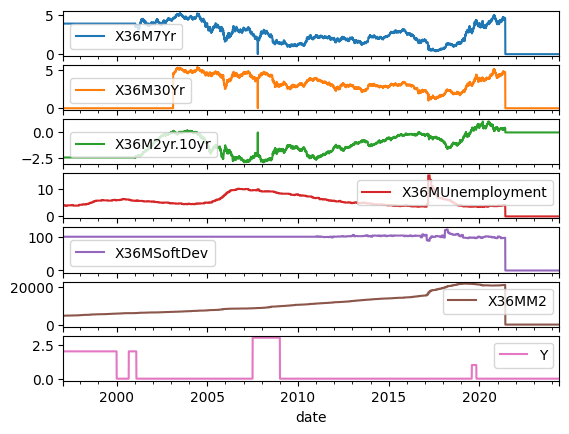

In [ ]:
#TEAM RL
#This code displays graphs for the last set of variables and the Y variable
data.set_index('date')[['X36M7Yr', 'X36M30Yr', 'X36M2yr.10yr', 'X36MUnemployment', 'X36MSoftDev', 'X36MM2', 'Y']].plot(subplots=True)

In [ ]:
#TEAM RL
#This code sets the 'date2' field as an index.

data.set_index('date', inplace=True)

In [ ]:
#TEAM RL
#This code shows the headers to see if the data came in as expected
data.head()

,X2Yr,X30Yr,X2yr.10yr,Unemployment,GDP,X3MUnemployment,X6M1Mo,X6M5Yr,X6M30Yr,X6MSAHM,...,X24MCPI,X24MM2,X36M1Yr,X36M7Yr,X36M30Yr,X36M2yr.10yr,X36MUnemployment,X36MSoftDev,X36MM2,Y
date,,,,,,,,,,,,,,,,,,,,,
1997-01-26,1.94,0.0,2.44,5.2,0.0,4.9,0.88,3.36,0.0,0.03,...,164.7,4425.3,1.31,3.9,0.0,-2.44,4.1,99.595302,4679.4,2
1997-01-27,1.94,0.0,-2.44,5.2,0.0,4.9,0.88,3.36,0.0,0.03,...,164.7,4425.3,1.31,3.9,0.0,-2.44,4.1,99.595302,4679.4,2
1997-01-28,1.94,0.0,-2.44,5.2,0.0,4.9,0.88,3.36,0.0,0.03,...,164.7,4425.3,1.31,3.9,0.0,-2.44,4.1,99.595302,4679.4,2
1997-01-29,1.94,0.0,-2.44,5.2,0.0,4.9,0.88,3.36,0.0,0.03,...,164.7,4425.3,1.31,3.9,0.0,-2.44,4.1,99.595302,4679.4,2
1997-01-30,1.94,0.0,-2.44,5.2,0.0,4.9,0.88,3.36,0.0,0.03,...,164.7,4425.3,1.31,3.9,0.0,-2.44,4.1,99.595302,4679.4,2


## Prepare the data scaling and create the sliding windows.

In [ ]:
#TEAM RL
#This code scales the non date columns in order to process them in the fully connected network.

col_to_scale = []
for col in data.columns:
    if col != 'Y':
        col_to_scale.append(col)
print(col_to_scale)

['X2Yr', 'X30Yr', 'X2yr.10yr', 'Unemployment', 'GDP', 'X3MUnemployment', 'X6M1Mo', 'X6M5Yr', 'X6M30Yr', 'X6MSAHM', 'X6MCPI', 'X6MM2', 'X12M1Mo', 'X12M7Yr', 'X12M30Yr', 'X12MSAHM', 'X12MUnemployment', 'X12MM2', 'X12MGDP', 'X18M1Mo', 'X18M5Yr', 'X18M30Yr', 'X18MSAHM', 'X18MUnemployment', 'X18MSoftDev', 'X18MM2', 'X18MGDP', 'X24M1Mo', 'X24M5Yr', 'X24M30Yr', 'X24M2yr.10yr', 'X24MSAHM', 'X24MUnemployment', 'X24MSoftDev', 'X24MCPI', 'X24MM2', 'X36M1Yr', 'X36M7Yr', 'X36M30Yr', 'X36M2yr.10yr', 'X36MUnemployment', 'X36MSoftDev', 'X36MM2']


In [ ]:
#TEAM RL
#This code displays the data types to insure they are formatted for the model to accept.
data.dtypes

In [ ]:
#TEAM RL
#This code defines a sliding window as follows:

#SlidingWindow(df, w, s, lag)
#Four Arguments:
# df: Is the DataFrame being processed.
# w: Represents the window size, the number of rows or time steps included in each sliding window.
# s: Represents the stride (step size), determining how far the window moves forward each time.
# lag: Represents the lag parameter, indicating how much earlier the data should start in relation to the current time step.
def SlidingWindow(df,w,s,lag):
    X=[]
    Y=[]
    for i in range(0,len(df)-lag*w,s):
        x = np.array(df.iloc[i:i+w,:43])
        y = np.array(df.iloc[i+w-1,-1])
        X.append(x)
        Y.append(y)

    X=np.array(X)
    Y=np.array(Y)

    return X,Y

In [ ]:
#TEAM RL
#This code defines a sliding window as follows:

#SlidingWindow(df, w, s, lag)
#Four Arguments:
# df: Is the DataFrame being processed.
# w: Represents the window size, the number of rows or time steps included in each sliding window.
# s: Represents the stride (step size), determining how far the window moves forward each time.
# lag: Represents the lag parameter, indicating how much earlier the data should start in relation to the current time step.

w=30
s=10
lag=1

X, y = SlidingWindow(data,w,s,lag)

In [ ]:
#TEAM RL
# THis code identifies the shape of the data
X.shape

(996, 30, 43)

In [ ]:
#TEAM RL
# This code identifies the y shape of the data
y.shape

(996,)

In [ ]:
#Team RL
#This code identifies the Y
y[0]

2

In [ ]:
#TEAM RL
#This code imports the MinMaxScaler
from sklearn.preprocessing import MinMaxScaler

class MinMaxScaler3D(MinMaxScaler):

    def fit_transform(self, X, y=None):
        x = np.reshape(X, newshape=(X.shape[0]*X.shape[1], X.shape[2]))
        return np.reshape(super().fit_transform(x, y=y), newshape=X.shape)


In [ ]:
#Team RL
#This code defines the scaler and X
scaler = MinMaxScaler3D()
X = scaler.fit_transform(X)

In [ ]:
#TEAM RL
#THis block defines the shape of X
X.shape

(996, 30, 43)

In [ ]:
#TEAM RL
#This block imports the train test split
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

#X_train, y_train = X[:796], y[:796]
#X_test, y_test = X[796:], y[796:]

In [ ]:
#TEAM RL
#This code displays the sapes of the data

X_train.shape, X_test.shape, y_train.shape, y_test.shape

((796, 30, 43), (200, 30, 43), (796,), (200,))

In [ ]:
# TEAM RL
# Get unique values and their counts
unique, counts = np.unique(y_train, return_counts=True)

# Create a dictionary to see the distribution of each class
dis_train = dict(zip(unique, counts))
print(dis_train)

{0: 649, 1: 7, 2: 96, 3: 44}


In [ ]:
#TEAM RL
# Get unique values and their counts
unique, counts = np.unique(y_test, return_counts=True)

# Create a dictionary to see the distribution of each class
dis_test = dict(zip(unique, counts))
print(dis_test)

{0: 163, 1: 2, 2: 24, 3: 11}


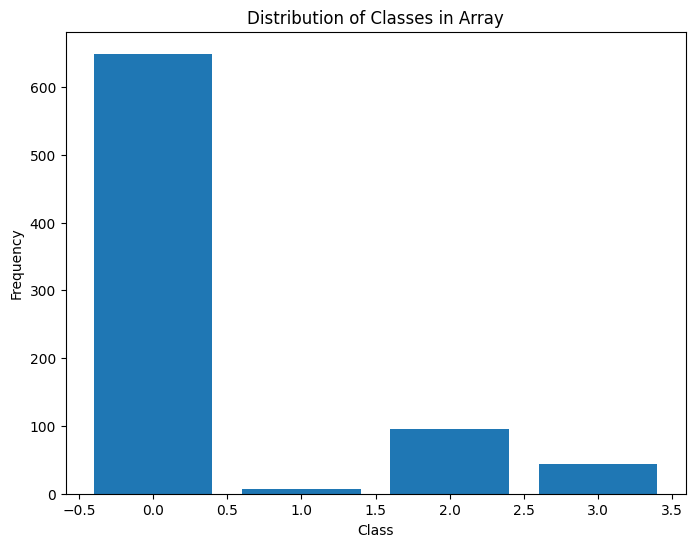

In [ ]:
#TEAM RL
# Plotting the distribution
plt.figure(figsize=(8, 6))
plt.bar(dis_train.keys(), dis_train.values())
plt.xlabel('Class')
plt.ylabel('Frequency')
plt.title('Distribution of Classes in Array')
plt.show()

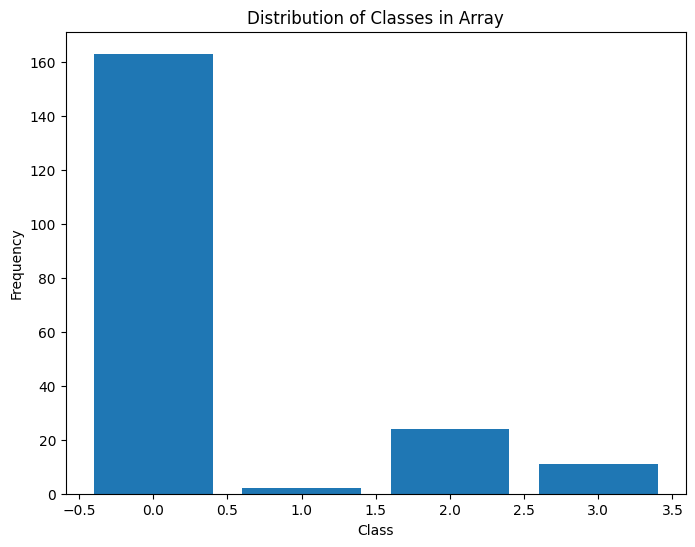

In [ ]:
#TEAM RL
# Plotting the distribution
plt.figure(figsize=(8, 6))
plt.bar(dis_test.keys(), dis_test.values())
plt.xlabel('Class')
plt.ylabel('Frequency')
plt.title('Distribution of Classes in Array')
plt.show()

In [ ]:
#TEAM RL
#This code reshapes the training data
X_train = X_train.reshape(-1,1,30,43)

In [ ]:
#TEAM RL
#This code displays the shape of the data
X_train.shape

(796, 1, 30, 43)

In [ ]:
#TEAM RL
#This code reshapes the test data
X_test = X_test.reshape(-1,1,30,43)

In [ ]:
#TEAM RL
#This code displays the test shape
X_test.shape

(200, 1, 30, 43)

## Feed the data through dataloader to create a batch of 16 to input data into the model the model

In [ ]:
#TEAM RL
#Defines the number of batches
#Converts the results into pandas so we can evaluate the results.
B=16
train_dataset = TensorDataset(torch.tensor(X_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.long))
test_dataset = TensorDataset(torch.tensor(X_test, dtype=torch.float32), torch.tensor(y_test, dtype=torch.long))
training_loader = DataLoader(train_dataset,batch_size=B, shuffle=True)
testing_loader = DataLoader(test_dataset)

In [ ]:
#Team RL
#This code checks the shape of the train data.
X_train[0].shape

(1, 30, 43)

## Base model

In [ ]:
#TEAM RL
#How many values are in the input? We use this to help determine the size of subsequent layers
H=30
W=43
D = H*W #30 days * 18 features images
#How many channels are in the input?
C = 1
#How many classes are there?
classes = 4
#How many filters should we use
filters = 16
#how large should our filters be?
K = 3
#for comparison, lets define a linear model of similar complexity
model_linear = nn.Sequential(
  nn.Flatten(), #(B, C, W, H) -> (B, C*W*H) = (B,D)
  nn.Linear(D, 256),
  nn.Tanh(),
  nn.Linear(256, classes),
)

#A simple convolutional network:
model_cnn = nn.Sequential(
  #Conv2d follows the pattern of:
  #Conv2d(# of input channels, #filters/output-channels, #filter-size)
  nn.Conv2d(C, filters, K, padding=K//2), #$x \circledast G$
  nn.Tanh(),#Activation functions work on any size tensorr
  nn.Flatten(), #Convert from (B, C, W, H) ->(B, D). This way we can use a Linear layer after
  nn.Linear(filters*D, classes),
)

In [ ]:
#TEAM RL
#This code set sthe device to access the GPU
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

In [ ]:
#TEAM RL
#This code imports the accuracy score and f1_score from the sklearn metrics.
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score

In [ ]:
#TEAM RL
#This code defines the loss function as Cross Enthropy Loss
#This cude defines the results
loss_func = nn.CrossEntropyLoss()
cnn_results = train_network(model_cnn, loss_func, training_loader, test_loader=testing_loader, score_funcs={'Acc': accuracy_score,'F1': f1_score}, device=device, epochs=20)
fc_results = train_network(model_linear, loss_func, training_loader, test_loader=testing_loader, score_funcs={'Acc': accuracy_score,'F1': f1_score}, device=device, epochs=20)

Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

<Axes: xlabel='epoch', ylabel='test Acc'>

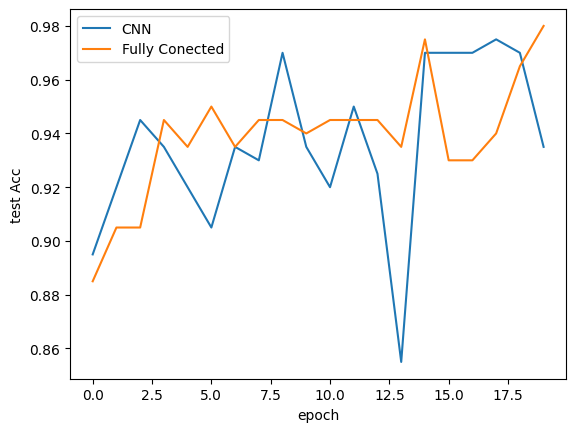

In [ ]:
#TEAM RL
#This code compares the accuracy between the F1 and accuracy of the test data by epoch
sns.lineplot(x='epoch', y='test Acc', data=cnn_results, label='CNN')
sns.lineplot(x='epoch', y='test Acc', data=fc_results, label='Fully Conected')




<Axes: xlabel='epoch', ylabel='test F1'>

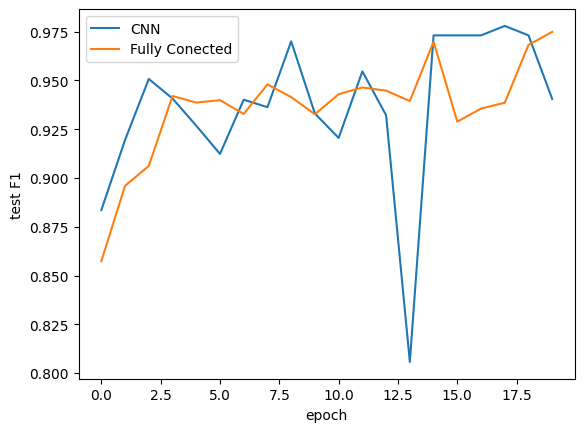

In [ ]:
#TEAM RL
#This code compares the Acc test and train accuracy by epoch
sns.lineplot(x='epoch', y='test F1', data=cnn_results, label='CNN')
sns.lineplot(x='epoch', y='test F1', data=fc_results, label='Fully Conected')


<Axes: xlabel='epoch', ylabel='test Acc'>

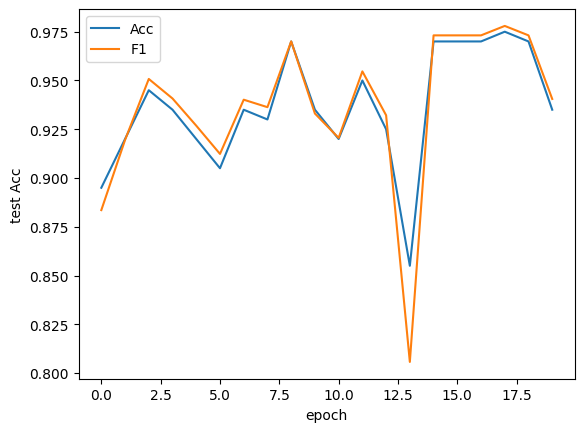

In [ ]:
#TEAM RL
#This code compares accuracy by epock for test and train f1
sns.lineplot(x='epoch', y='test Acc', data=cnn_results, label='Acc')
sns.lineplot(x='epoch', y='test F1', data=cnn_results, label='F1')

<Axes: xlabel='epoch', ylabel='train F1'>

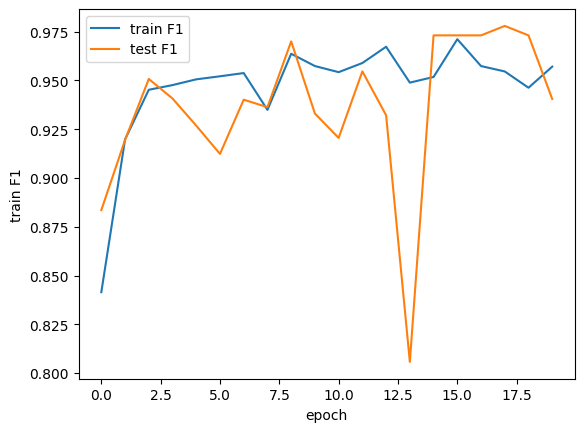

In [ ]:
#TEAM RL
#This code compares the training loss by epoch
sns.lineplot(x='epoch', y='train F1', data=cnn_results, label='train F1')
sns.lineplot(x='epoch', y='test F1', data=cnn_results, label='test F1')

## Test Schedulers

In [ ]:
#TEAM RL
#This code defines the learning rate and number of epochs
eta_0 = 0.1
epochs = 30

In [ ]:
#TEAM RL
#This code runs the linear model for the results
#This code sets the target learning rate
#This code re-randomizes the weights
#This code sets the deccay rate

model_cnn.apply(weight_reset)#re-randomize the weights of our model so that we don't need to define it again

eta_min = 0.0001 #Our desired final learning rate $\eta_{\mathit{min}}$

gamma_expo = (eta_min/eta_0)**(1/epochs)#compute $\gamma$ that results in $\eta_{\mathit{min}}$

optimizer = torch.optim.SGD(model_cnn.parameters(), lr=eta_0) #Set up the optimizer
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma_expo)#pick a schedule and pass the optimizer in
#train like normal and pass along the desired optimizer and schedule
cnn_results_expolr = train_network(model_cnn, loss_func, training_loader, test_loader=testing_loader, epochs=epochs, optimizer=optimizer, lr_schedule=scheduler, score_funcs={'F1': f1_score}, device=device)

Epoch:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

<Axes: xlabel='epoch', ylabel='test loss'>

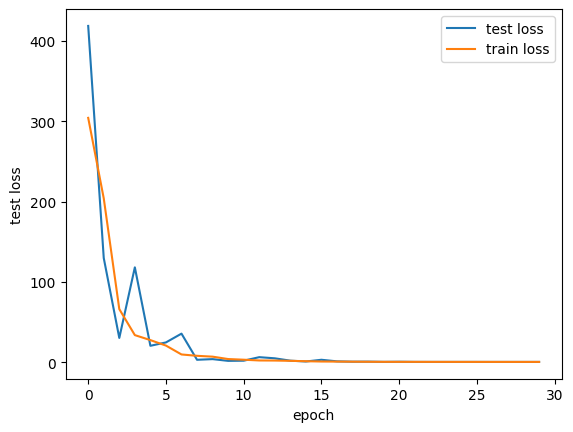

In [ ]:
#TEAM RL
#This code plots the loss for the train and test models
sns.lineplot(x='epoch', y='test loss', data=cnn_results_expolr, label='test loss')
sns.lineplot(x='epoch', y='train loss', data=cnn_results_expolr, label='train loss')

In [ ]:
#Team RL
#This code resets the weights, and runs the CNN LR Scheduler with SGD model
model_cnn.apply(weight_reset)

optimizer = torch.optim.SGD(model_cnn.parameters(), lr=eta_0)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, epochs//5, gamma=0.003)#I'm telling it to step down by a factor of $\gamma$ every epochs/4, so this will happen 4 times total.
cnn_results_Steplr = train_network(model_cnn, loss_func, training_loader, test_loader=testing_loader, epochs=epochs, optimizer=optimizer, lr_schedule=scheduler, score_funcs={'F1': f1_score}, device=device)

Epoch:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

In [ ]:
#TEAM RL
#This code runs the cosine LR model
model_cnn.apply(weight_reset)

optimizer = torch.optim.SGD(model_cnn.parameters(), lr=eta_0)
#Telling the cosine to go down/up/down (thats 3), if we were doing more than 10 epochs I would push this higher
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, epochs//5, eta_min=0.0001)
cnn_results_Cosinelr = train_network(model_cnn, loss_func, training_loader, test_loader=testing_loader, epochs=epochs, optimizer=optimizer, lr_schedule=scheduler, score_funcs={'F1': f1_score}, device=device)

Epoch:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

In [ ]:
model_cnn.apply(weight_reset) #Resetting the weights again so we don't have to define a new model.

#create a training and validation sub-set, since we do not have an explicit validation and test set
#create a training and validation sub-set, since we do not have an explicit validation and test set

X_train2, X_val, y_train2, y_val = train_test_split(X_train, y_train, test_size=0.2, stratify=y_train, random_state=42)

train_dataset2 = TensorDataset(torch.tensor(X_train2, dtype=torch.float32), torch.tensor(y_train2, dtype=torch.long))
val_dataset = TensorDataset(torch.tensor(X_val, dtype=torch.float32), torch.tensor(y_val, dtype=torch.long))
B=16

#create loaders for the train and validation sub-sets.
train_sub_loader = DataLoader(train_dataset2,batch_size=B, shuffle=True)
val_sub_loader = DataLoader(val_dataset,batch_size=B)

#our test loader stays the same, never alter or peek on your test data!

optimizer = torch.optim.SGD(model_cnn.parameters(), lr=eta_0)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.63, patience=10)#Set up our plateau schedule using gamma=0.63
cnn_results_plateau = train_network(model_cnn, loss_func, train_sub_loader, val_loader=val_sub_loader, test_loader=testing_loader, epochs=epochs, optimizer=optimizer, lr_schedule=scheduler, score_funcs={'F1': f1_score}, device=device)

Epoch:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

<Axes: xlabel='epoch', ylabel='test F1'>

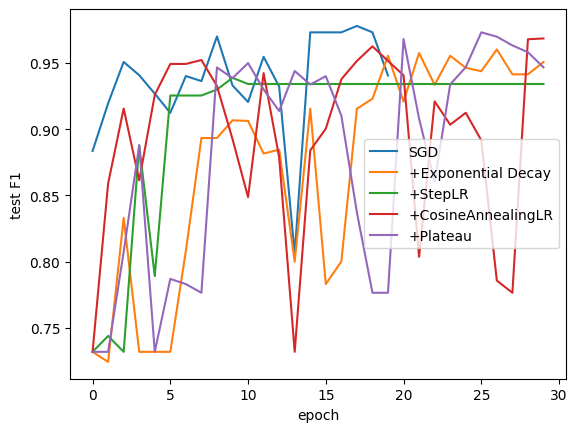

In [ ]:
#TEAM RL
#This code compares the different models

sns.lineplot(x='epoch', y='test F1', data=cnn_results, label='SGD')
sns.lineplot(x='epoch', y='test F1', data=cnn_results_expolr, label='+Exponential Decay')
sns.lineplot(x='epoch', y='test F1', data=cnn_results_Steplr, label='+StepLR')
sns.lineplot(x='epoch', y='test F1', data=cnn_results_Cosinelr, label='+CosineAnnealingLR')
sns.lineplot(x='epoch', y='test F1', data=cnn_results_plateau, label='+Plateau')

In [ ]:
#TEAM RL
#This code displays the results of the cnn model

cnn_results_expolr.tail()

,epoch,total time,train loss,test loss,train F1,test F1
25,25,4.190199,0.302817,0.298959,0.942222,0.943738
26,26,4.331918,0.295143,0.279831,0.942177,0.960207
27,27,4.458435,0.291527,0.284929,0.947560,0.941396
28,28,4.583456,0.286605,0.277731,0.945345,0.941396
29,29,4.710191,0.284222,0.272961,0.945371,0.950666


<Axes: xlabel='epoch', ylabel='test F1'>

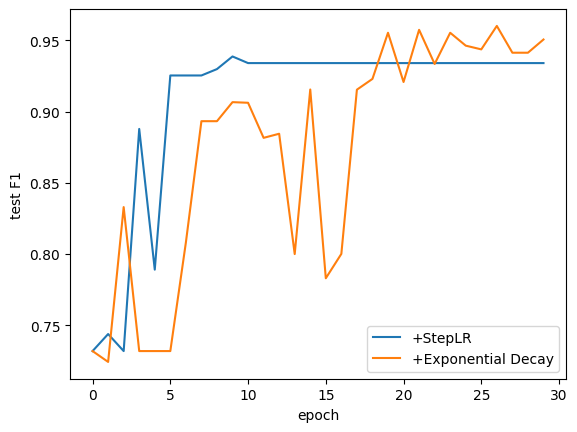

In [ ]:
#TEAM RL
#This code compares the Steplr and the expolr

sns.lineplot(x='epoch', y='test F1', data=cnn_results_Steplr, label='+StepLR')
sns.lineplot(x='epoch', y='test F1', data=cnn_results_expolr, label='+Exponential Decay')


## Test Optimizers

In [ ]:
#TEAM RL
#This code sets up and runs the cnn with momentum

model_cnn.apply(weight_reset)

optimizer = torch.optim.SGD(model_cnn.parameters(), lr=eta_0, momentum=0.9, nesterov=False)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma_expo)#pick a schedule and pass the optimizer in

cnn_results_momentum = train_network(model_cnn, loss_func, training_loader, test_loader=testing_loader, epochs=epochs, optimizer=optimizer, lr_schedule=scheduler, score_funcs={'Acc': accuracy_score,'F1': f1_score}, device=device)

Epoch:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

In [ ]:
#TEAM RL
#This code runs the CNN with nesterov momentum

model_cnn.apply(weight_reset)

optimizer = torch.optim.SGD(model_cnn.parameters(), lr=eta_0, momentum=0.9, nesterov=True)

cnn_results_nesterov = train_network(model_cnn, loss_func, training_loader, test_loader=testing_loader, epochs=epochs, optimizer=optimizer, lr_schedule=scheduler, score_funcs={'Acc': accuracy_score,'F1': f1_score}, device=device)

Epoch:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

In [ ]:
#TEAM RL
#This code runs the cnn with adamW

model_cnn.apply(weight_reset)

#We don't set the learning rate for Adam because it's default is the one you should probably
#always use, and it can be more sensitive to large changes in learning rate
optimizer = torch.optim.AdamW(model_cnn.parameters())
cnn_results_adamW = train_network(model_cnn, loss_func, training_loader, test_loader=testing_loader, epochs=epochs, optimizer=optimizer, lr_schedule=scheduler, score_funcs={'Acc': accuracy_score,'F1': f1_score}, device=device)

Epoch:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

In [ ]:
#TEAM RL
#Using the same model, for the gradient clipping use if the gradient is greater than 5 or -5 replace the value with 5 or -5

model_cnn.apply(weight_reset)

for p in model_cnn.parameters(): # this does $\operatorname{clip}_5(\boldsymbol{g})$
    p.register_hook(lambda grad: torch.clamp(grad, -5, 5))

optimizer = torch.optim.AdamW(model_cnn.parameters())
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma_expo)#pick a schedule and pass the optimizer in

cnn_results_adamW_clamp= train_network(model_cnn, loss_func, train_sub_loader,val_loader=val_sub_loader , test_loader=testing_loader, epochs=30, optimizer=optimizer,  lr_schedule=scheduler, score_funcs={'F1': accuracy_score}, device=device)

Epoch:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Validating:   0%|          | 0/10 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

<Axes: xlabel='epoch', ylabel='test F1'>

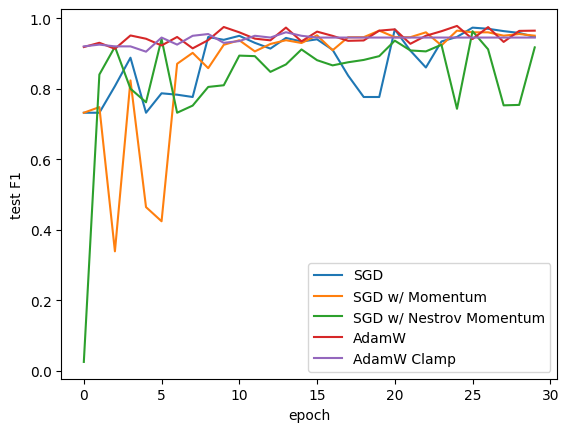

In [ ]:
#TEAM RL
#This code compares the different models.

sns.lineplot(x='epoch', y='test F1', data=cnn_results_plateau, label='SGD')
sns.lineplot(x='epoch', y='test F1', data=cnn_results_momentum, label='SGD w/ Momentum')
sns.lineplot(x='epoch', y='test F1', data=cnn_results_nesterov, label='SGD w/ Nestrov Momentum')
sns.lineplot(x='epoch', y='test F1', data=cnn_results_adamW, label='AdamW')
sns.lineplot(x='epoch', y='test F1', data=cnn_results_adamW_clamp, label='AdamW Clamp')

<Axes: xlabel='epoch', ylabel='test F1'>

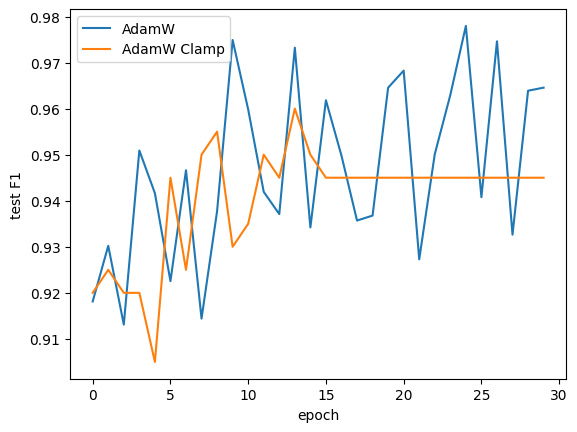

In [ ]:
#TEAM RL
#This code compares the adamW with adamW_clamp
sns.lineplot(x='epoch', y='test F1', data=cnn_results_adamW, label='AdamW')
sns.lineplot(x='epoch', y='test F1', data=cnn_results_adamW_clamp, label='AdamW Clamp')

In [ ]:
#TEAM RL
#This code displays the details of the adamW_clamp
cnn_results_adamW_clamp.tail()

,epoch,total time,train loss,val loss,test loss,train F1,val F1,test F1
25,25,4.034371,0.065678,0.093338,0.100571,0.962264,0.9375,0.945
26,26,4.195682,0.065393,0.093465,0.101286,0.966981,0.9375,0.945
27,27,4.362438,0.065450,0.093508,0.101460,0.965409,0.9375,0.945
28,28,4.543689,0.065554,0.093465,0.101390,0.966981,0.9375,0.945
29,29,4.769520,0.065130,0.093379,0.101201,0.965409,0.9375,0.945


In [ ]:
#TEAM RL
#This code displays the details of the adamW
cnn_results_adamW.tail()

,epoch,total time,train loss,test loss,train Acc,test Acc,train F1,test F1
25,25,5.058127,0.067356,0.162878,0.972362,0.940,0.972609,0.940769
26,26,5.225862,0.055310,0.072850,0.979899,0.975,0.980022,0.974614
27,27,5.380888,0.092264,0.260281,0.968593,0.925,0.968509,0.932634
28,28,5.550775,0.071164,0.119609,0.972362,0.960,0.972332,0.963890
29,29,5.718290,0.053431,0.120249,0.973618,0.970,0.973734,0.964554


###**Set Parameters for Optuna**

In [ ]:
#TEAM RL
#Set parameters to optimize hyperparameters
#How many channels are in the input?
C = 1
#How many classes are there?
classes = 4
# How many variables
H=30
W=43
D = H*W #30 days * 43 features images
#How many samples per batch?
B = 16
epochs = 30
hidden_nodes = 30

eta_min = 0.0001 #Our desired final learning rate $\eta_{\mathit{min}}$

gamma_expo = (eta_min/eta_0)**(1/epochs)#compute $\gamma$ that results in $\eta_{\mathit{min}}$


device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

In [ ]:
#TEAM RL
# define the model with parameters to be optimized , layers, neurons and learning rate
def objective(trial):

    X_train2, X_val, y_train2, y_val = train_test_split(X_train, y_train, test_size=0.2, stratify=y_train, random_state=42)

    train_dataset2 = TensorDataset(torch.tensor(X_train2, dtype=torch.float32), torch.tensor(y_train2, dtype=torch.long))
    val_dataset = TensorDataset(torch.tensor(X_val, dtype=torch.float32), torch.tensor(y_val, dtype=torch.long))
    B=16

    #create loaders for the train and validation sub-sets.
    t_loader = DataLoader(train_dataset2,batch_size=B, shuffle=True)
    v_loader = DataLoader(val_dataset,batch_size=B)

   #Hidden layer size
    filters = trial.suggest_int('filters', 16, 32)
    #K = trial.suggest_int('kernel', 3, 6)
    #filters = 16
    K = 3
    layers = trial.suggest_int('hidden_layers', 1, 6)
    #How many channels are in the input?
    C = 1
    #How many classes are there?
    classes = 4

    #At least one hidden layer, that take in D inputs
    sequential_layers = [
        nn.Conv2d(C, filters, K, padding=K//2),
        nn.Tanh(),
    ]
    #Now lets add in a variable number of hidden layers, depending on what Optuna gave us for the "layers" parameter
    for _ in range(layers-1):
        sequential_layers.append( nn.Conv2d(filters, filters, K, padding=K//2) )
        sequential_layers.append( nn.Tanh() )

    #Output layer
    sequential_layers.append(nn.Flatten())
    sequential_layers.append(nn.Linear(filters*(H)*(W), classes))


    #Now turn the list of layers into a PyTorch Sequential Module
    cnn_model_op = nn.Sequential(*sequential_layers)
    #What should our global learning rate be? Notice that we can ask for new hyper-parameters from optuna whenever we want.
    eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


    for p in model_cnn.parameters(): # this does $\operatorname{clip}_5(\boldsymbol{g})$
        p.register_hook(lambda grad: torch.clamp(grad, -5, 5))

    optimizer = torch.optim.AdamW(cnn_model_op.parameters())
    scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma_expo)

    results = train_network(cnn_model_op, loss_func, t_loader, test_loader=v_loader,
                                     epochs=10, optimizer=optimizer, lr_schedule=scheduler,
                                     score_funcs={'F1': f1_score}, device=device,
                                     disable_tqdm=True)

    return results['test F1'].iloc[-1]  # A objective value linked with the Trial object.

In [ ]:
#TEAM RL
# Install Optuna
!pip install optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 364.4/364.4 kB 17.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.5/233.5 kB 20.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 7.6 MB/s eta 0:00:00


In [ ]:
#TEAM RL
# Import optuna
import optuna

In [ ]:
#TEAM RL
#This code defines the learning rate, the desired learning rate, and the number of epochs
eta_0 = 0.1
epochs = 30
eta_min = 0.0001 #Our desired final learning rate $\eta_{\mathit{min}}$

loss_func = nn.CrossEntropyLoss()

In [ ]:
#TEAM RL
#This code defines the study
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=75) #Normally we would do more like 50-100 trials,
#but we are doing less to make sure this notebook runs in a reasonable amount of time

[I 2024-11-18 16:28:26,871] A new study created in memory with name: no-name-c9e23c9e-153f-42f4-9abd-8640931a0e89
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:28:29,664] Trial 0 finished with value: 0.9546807504917391 and parameters: {'filters': 26, 'hidden_layers': 5, 'learning_rate': 0.005171425369246362}. Best is trial 0 with value: 0.9546807504917391.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:28:32,773] Trial 1 finished with value: 0.9581403643546972 and parameters: {'filters': 28, 'hidden_layers': 3, 'learning_rate': 0.00020576311923548715}. Best is trial 1 with value: 0.9581403643546972.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:28:35,529] Trial 2 finished with value: 0.9411090130699838 and parameters: {'filters': 17, 'hidden_layers': 4, 'learning_rate': 0.005887286152040251}. Best is trial 1 with value: 0.9581403643546972.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:28:38,727] Trial 3 finished with value: 0.9609011627906977 and parameters: {'filters': 25, 'hidden_layers': 6, 'learning_rate': 0.0006071492839431914}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:28:40,829] Trial 4 finished with value: 0.9609011627906977 and parameters: {'filters': 18, 'hidden_layers': 2, 'learning_rate': 1.5735517528301824e-05}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:28:43,879] Trial 5 finished with value: 0.9417672413793104 and parameters: {'filters': 29, 'hidden_layers': 6, 'learning_rate': 0.0023154220502613334}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:28:46,210] Trial 6 finished with value: 0.9501786129182157 and parameters: {'filters': 26, 'hidden_layers': 3, 'learning_rate': 0.0009846645476056252}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:28:48,237] Trial 7 finished with value: 0.9581403643546972 and parameters: {'filters': 19, 'hidden_layers': 1, 'learning_rate': 0.00866206411648123}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:28:50,311] Trial 8 finished with value: 0.9434201926384589 and parameters: {'filters': 29, 'hidden_layers': 2, 'learning_rate': 0.0002866431159803829}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:28:53,243] Trial 9 finished with value: 0.9546807504917391 and parameters: {'filters': 30, 'hidden_layers': 6, 'learning_rate': 0.0012753229408864891}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:28:56,064] Trial 10 finished with value: 0.9609011627906977 and parameters: {'filters': 22, 'hidden_layers': 5, 'learning_rate': 6.19750966496952e-05}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:28:58,559] Trial 11 finished with value: 0.9488603977531815 and parameters: {'filters': 22, 'hidden_layers': 1, 'learning_rate': 1.1224076636130892e-05}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:01,419] Trial 12 finished with value: 0.9488603977531815 and parameters: {'filters': 16, 'hidden_layers': 2, 'learning_rate': 1.076301637785815e-05}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:05,835] Trial 13 finished with value: 0.9511429901463796 and parameters: {'filters': 21, 'hidden_layers': 4, 'learning_rate': 5.2409068301942585e-05}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:08,391] Trial 14 finished with value: 0.9411090130699838 and parameters: {'filters': 32, 'hidden_layers': 2, 'learning_rate': 7.765727662704764e-05}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:11,262] Trial 15 finished with value: 0.9503558400781804 and parameters: {'filters': 24, 'hidden_layers': 5, 'learning_rate': 0.0007645140167303439}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:13,655] Trial 16 finished with value: 0.9411090130699838 and parameters: {'filters': 19, 'hidden_layers': 3, 'learning_rate': 2.8897500216707175e-05}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:17,324] Trial 17 finished with value: 0.940761689291101 and parameters: {'filters': 25, 'hidden_layers': 4, 'learning_rate': 0.00019559990753318724}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:20,100] Trial 18 finished with value: 0.9488603977531815 and parameters: {'filters': 20, 'hidden_layers': 2, 'learning_rate': 0.0005076796050874489}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:23,549] Trial 19 finished with value: 0.9354411764705881 and parameters: {'filters': 23, 'hidden_layers': 6, 'learning_rate': 0.00011705347158462055}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:25,738] Trial 20 finished with value: 0.9354411764705881 and parameters: {'filters': 18, 'hidden_layers': 1, 'learning_rate': 2.155882534380306e-05}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:28,960] Trial 21 finished with value: 0.9448387014834381 and parameters: {'filters': 22, 'hidden_layers': 5, 'learning_rate': 3.8265804161481634e-05}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:32,433] Trial 22 finished with value: 0.9545046585573262 and parameters: {'filters': 24, 'hidden_layers': 5, 'learning_rate': 0.00010589100610797862}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:35,481] Trial 23 finished with value: 0.9545046585573262 and parameters: {'filters': 21, 'hidden_layers': 6, 'learning_rate': 1.697843197044029e-05}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:38,382] Trial 24 finished with value: 0.9354411764705881 and parameters: {'filters': 27, 'hidden_layers': 5, 'learning_rate': 4.792680616292653e-05}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:41,619] Trial 25 finished with value: 0.9432967752600392 and parameters: {'filters': 16, 'hidden_layers': 6, 'learning_rate': 0.0006049169212690391}. Best is trial 3 with value: 0.9609011627906977.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:44,637] Trial 26 finished with value: 0.9649302080382715 and parameters: {'filters': 23, 'hidden_layers': 4, 'learning_rate': 0.0018781459527602402}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:47,245] Trial 27 finished with value: 0.9609011627906977 and parameters: {'filters': 24, 'hidden_layers': 3, 'learning_rate': 0.001984590908002413}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:50,342] Trial 28 finished with value: 0.9609011627906977 and parameters: {'filters': 26, 'hidden_layers': 4, 'learning_rate': 0.0028714945270377906}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:53,244] Trial 29 finished with value: 0.9545046585573262 and parameters: {'filters': 25, 'hidden_layers': 4, 'learning_rate': 0.00430709394889137}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:55,359] Trial 30 finished with value: 0.9411090130699838 and parameters: {'filters': 18, 'hidden_layers': 2, 'learning_rate': 0.00048583228899018997}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:29:57,957] Trial 31 finished with value: 0.9411090130699838 and parameters: {'filters': 22, 'hidden_layers': 5, 'learning_rate': 0.0014622540824898486}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:00,762] Trial 32 finished with value: 0.9545046585573262 and parameters: {'filters': 23, 'hidden_layers': 5, 'learning_rate': 0.00018929896935410037}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:03,655] Trial 33 finished with value: 0.9532081749049428 and parameters: {'filters': 20, 'hidden_layers': 5, 'learning_rate': 0.00032776209867555205}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:06,594] Trial 34 finished with value: 0.9605913702690378 and parameters: {'filters': 27, 'hidden_layers': 4, 'learning_rate': 1.8303837586508137e-05}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:09,596] Trial 35 finished with value: 0.9574273518769788 and parameters: {'filters': 23, 'hidden_layers': 6, 'learning_rate': 0.0038392462968081}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:12,436] Trial 36 finished with value: 0.9411090130699838 and parameters: {'filters': 21, 'hidden_layers': 3, 'learning_rate': 7.643671389880964e-05}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:14,949] Trial 37 finished with value: 0.9432967752600392 and parameters: {'filters': 25, 'hidden_layers': 3, 'learning_rate': 0.008861374341131212}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:17,837] Trial 38 finished with value: 0.9417672413793104 and parameters: {'filters': 17, 'hidden_layers': 6, 'learning_rate': 0.0009382150335010226}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:20,836] Trial 39 finished with value: 0.9411090130699838 and parameters: {'filters': 28, 'hidden_layers': 4, 'learning_rate': 0.0003469831660921412}. Best is trial 26 with value: 0.9649302080382715.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:23,776] Trial 40 finished with value: 0.9651074423480084 and parameters: {'filters': 20, 'hidden_layers': 5, 'learning_rate': 0.0014809916429001852}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:26,689] Trial 41 finished with value: 0.9286734068627451 and parameters: {'filters': 19, 'hidden_layers': 5, 'learning_rate': 0.0014857489875745183}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:29,997] Trial 42 finished with value: 0.954657335907336 and parameters: {'filters': 20, 'hidden_layers': 5, 'learning_rate': 0.0022246085633305882}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:33,108] Trial 43 finished with value: 0.9609011627906977 and parameters: {'filters': 18, 'hidden_layers': 6, 'learning_rate': 0.0011808361480503745}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:35,655] Trial 44 finished with value: 0.9488603977531815 and parameters: {'filters': 22, 'hidden_layers': 4, 'learning_rate': 0.0007112574332119056}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:37,775] Trial 45 finished with value: 0.9272000483792935 and parameters: {'filters': 19, 'hidden_layers': 1, 'learning_rate': 0.00620283565930791}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:40,464] Trial 46 finished with value: 0.9609011627906977 and parameters: {'filters': 17, 'hidden_layers': 5, 'learning_rate': 1.3869735085234318e-05}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:43,958] Trial 47 finished with value: 0.9552562345242306 and parameters: {'filters': 21, 'hidden_layers': 6, 'learning_rate': 2.773215102494035e-05}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:46,648] Trial 48 finished with value: 0.9545046585573262 and parameters: {'filters': 23, 'hidden_layers': 3, 'learning_rate': 0.0027774111715742353}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:49,373] Trial 49 finished with value: 0.9411090130699838 and parameters: {'filters': 20, 'hidden_layers': 4, 'learning_rate': 0.00024486163575249104}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:52,362] Trial 50 finished with value: 0.9501786129182157 and parameters: {'filters': 26, 'hidden_layers': 4, 'learning_rate': 0.000896077130000277}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:54,950] Trial 51 finished with value: 0.9354411764705881 and parameters: {'filters': 24, 'hidden_layers': 2, 'learning_rate': 0.0018782751946028206}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:57,369] Trial 52 finished with value: 0.9490103543660287 and parameters: {'filters': 24, 'hidden_layers': 3, 'learning_rate': 0.0019787165578810167}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:30:59,753] Trial 53 finished with value: 0.9545046585573262 and parameters: {'filters': 25, 'hidden_layers': 3, 'learning_rate': 0.0030440328950155798}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:02,012] Trial 54 finished with value: 0.9609011627906977 and parameters: {'filters': 22, 'hidden_layers': 2, 'learning_rate': 0.00014554918972276883}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:04,298] Trial 55 finished with value: 0.9430435258092738 and parameters: {'filters': 24, 'hidden_layers': 1, 'learning_rate': 0.0011442731863269176}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:06,877] Trial 56 finished with value: 0.9545046585573262 and parameters: {'filters': 23, 'hidden_layers': 3, 'learning_rate': 0.0003989353784910877}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:09,872] Trial 57 finished with value: 0.9546807504917391 and parameters: {'filters': 32, 'hidden_layers': 5, 'learning_rate': 0.0016286310026850574}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:13,182] Trial 58 finished with value: 0.9496918402777779 and parameters: {'filters': 21, 'hidden_layers': 5, 'learning_rate': 6.77029903483215e-05}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:15,566] Trial 59 finished with value: 0.9439162922113289 and parameters: {'filters': 27, 'hidden_layers': 2, 'learning_rate': 0.0006669408534498382}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:18,338] Trial 60 finished with value: 0.9419340276059962 and parameters: {'filters': 25, 'hidden_layers': 4, 'learning_rate': 0.007025242212875157}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:20,979] Trial 61 finished with value: 0.9474358974358974 and parameters: {'filters': 26, 'hidden_layers': 4, 'learning_rate': 0.0029038383454845123}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:23,866] Trial 62 finished with value: 0.9411090130699838 and parameters: {'filters': 28, 'hidden_layers': 4, 'learning_rate': 0.0034388378315324602}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:26,641] Trial 63 finished with value: 0.9587786869133618 and parameters: {'filters': 29, 'hidden_layers': 4, 'learning_rate': 0.005030597880451986}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:29,053] Trial 64 finished with value: 0.9609011627906977 and parameters: {'filters': 26, 'hidden_layers': 3, 'learning_rate': 0.0022843510687924787}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:32,111] Trial 65 finished with value: 0.9474358974358974 and parameters: {'filters': 19, 'hidden_layers': 6, 'learning_rate': 0.0005359806876715862}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:34,921] Trial 66 finished with value: 0.9474358974358974 and parameters: {'filters': 25, 'hidden_layers': 5, 'learning_rate': 0.004468558367742104}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:37,873] Trial 67 finished with value: 0.9488603977531815 and parameters: {'filters': 23, 'hidden_layers': 4, 'learning_rate': 3.516851222690183e-05}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:40,949] Trial 68 finished with value: 0.9411090130699838 and parameters: {'filters': 20, 'hidden_layers': 5, 'learning_rate': 1.0272717251667033e-05}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:43,519] Trial 69 finished with value: 0.9609011627906977 and parameters: {'filters': 22, 'hidden_layers': 3, 'learning_rate': 0.0008705410032921407}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:47,203] Trial 70 finished with value: 0.9355490890688258 and parameters: {'filters': 27, 'hidden_layers': 6, 'learning_rate': 0.002652939794939412}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:50,332] Trial 71 finished with value: 0.9468805704099822 and parameters: {'filters': 16, 'hidden_layers': 6, 'learning_rate': 0.0011929517025716925}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:53,318] Trial 72 finished with value: 0.9432014013118664 and parameters: {'filters': 18, 'hidden_layers': 6, 'learning_rate': 0.0011696689130724699}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:56,090] Trial 73 finished with value: 0.9609011627906977 and parameters: {'filters': 18, 'hidden_layers': 6, 'learning_rate': 0.0018093020848292027}. Best is trial 40 with value: 0.9651074423480084.
<ipython-input-64-78223d0e53e8>:43: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  eta_global = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)


Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

Training:   0%|          | 0/40 [00:00<?, ?it/s]

Testing:   0%|          | 0/10 [00:00<?, ?it/s]

[I 2024-11-18 16:31:59,001] Trial 74 finished with value: 0.9301332720588235 and parameters: {'filters': 17, 'hidden_layers': 6, 'learning_rate': 0.0013656051309352561}. Best is trial 40 with value: 0.9651074423480084.


In [ ]:
#TEAM RL1
#print the best values after optuna run with 15 trials.
print(study.best_params)

{'filters': 20, 'hidden_layers': 5, 'learning_rate': 0.0014809916429001852}


## Create Optimized model

In [ ]:
#TEAM RL
#This code prints the Tanh activation function
print(nn.Tanh)

<class 'torch.nn.modules.activation.Tanh'>


In [ ]:
#TEAM RL
#This code defines the deminsions of the data and the optuna model.

H=30
W=43
D = H*W #30 days * 18 features images
#How many channels are in the input?
C = 1
#How many classes are there?
classes = 4
#How many filters should we use
filters = 20
#how large should our filters be?
K = 3
epochs = 30


eta_0 = 0.0014809916429001852
eta_min = 0.0014809916429001852/10 #Our desired final learning rate $\eta_{\mathit{min}}$

gamma_expo = (eta_min/eta_0)**(1/epochs)#compute $\gamma$ that results in $\eta_{\mathit{min}}$

model_cnn_optuna = nn.Sequential(
    nn.Conv2d(C, filters, 3, padding=3//2),
    nn.Tanh(),  # This is correct
    nn.Conv2d(filters, filters, 3, padding=3//2),
    nn.Tanh(),  # This is correct
    nn.Conv2d(filters, filters, 3, padding=3//2),
    nn.Tanh(),  # Changed to create an instance
    nn.Conv2d(filters, filters, 3, padding=3//2),
    nn.Tanh(),  # Changed to create an instance
    nn.Conv2d(filters, filters, 3, padding=3//2),
    nn.Tanh(),  # Changed to create an instance
    nn.Flatten(),
    nn.Linear(filters*(H)*(W), classes),
)

loss_func = nn.CrossEntropyLoss()

optimizer = torch.optim.AdamW(model_cnn_optuna.parameters())
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma_expo)

cnn_optimal_results = train_network(model_cnn_optuna, loss_func, training_loader, test_loader=testing_loader,optimizer=optimizer, lr_schedule=scheduler,
 score_funcs={'Acc': accuracy_score,'F1': f1_score}, device=device, epochs=30)

Epoch:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

<Axes: xlabel='epoch', ylabel='test Acc'>

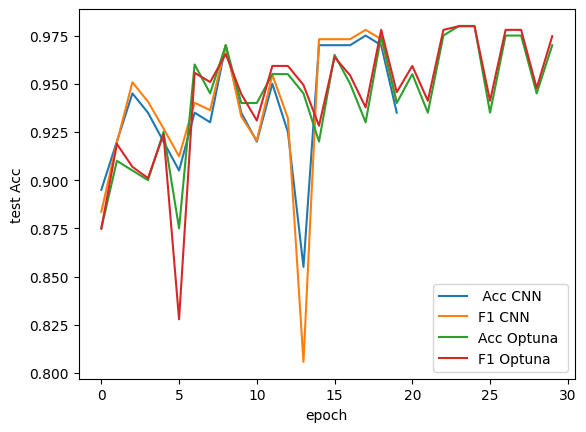

In [ ]:
#TEAM RL
#This code graphs the different cnn and optuna models
sns.lineplot(x='epoch', y='test Acc', data=cnn_results, label=' Acc CNN')
sns.lineplot(x='epoch', y='test F1', data=cnn_results, label='F1 CNN')
sns.lineplot(x='epoch', y='test Acc', data=cnn_optimal_results, label='Acc Optuna ')
sns.lineplot(x='epoch', y='test F1', data=cnn_optimal_results, label='F1 Optuna ')

<Axes: xlabel='epoch', ylabel='test Acc'>

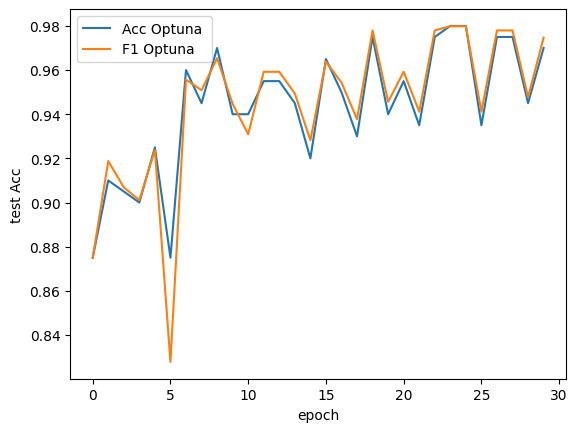

In [ ]:
#TEAM RL
#This code charts the acc and f1 for optuna
sns.lineplot(x='epoch', y='test Acc', data=cnn_optimal_results, label='Acc Optuna ')
sns.lineplot(x='epoch', y='test F1', data=cnn_optimal_results, label='F1 Optuna ')

In [ ]:
#TEAM RL
#This code gives details on the cnn model
cnn_optimal_results.tail()

,epoch,total time,train loss,test loss,train Acc,test Acc,train F1,test F1
25,25,6.358382,0.052744,0.120286,0.974874,0.935,0.974721,0.941175
26,26,6.634184,0.062742,0.067561,0.964824,0.975,0.964895,0.977958
27,27,6.878587,0.057404,0.055161,0.968593,0.975,0.968791,0.977958
28,28,7.118338,0.060437,0.087960,0.971106,0.945,0.970896,0.947772
29,29,7.314496,0.051773,0.090873,0.973618,0.970,0.973689,0.974690


##**ReLU**

In [ ]:
#TEAM RL
#This code defines the deminsions of the ReLU model

H=30
W=43
D = H*W #30 days * 18 features images
#How many channels are in the input?
C = 1
#How many classes are there?
classes = 4
#How many filters should we use
filters = 20
#how large should our filters be?
K = 3
epochs = 30


eta_0 = 0.0014809916429001852
eta_min = 0.0014809916429001852/10 #Our desired final learning rate $\eta_{\mathit{min}}$

gamma_expo = (eta_min/eta_0)**(1/epochs)#compute $\gamma$ that results in $\eta_{\mathit{min}}$

model_cnn_optuna_ReLU = nn.Sequential(
    nn.Conv2d(C, filters, 3, padding=3//2),
    nn.ReLU(),  # This is correct
    nn.Conv2d(filters, filters, 3, padding=3//2),
    nn.ReLU(),  # This is correct
    nn.Conv2d(filters, filters, 3, padding=3//2),
    nn.ReLU(),  # Changed to create an instance
    nn.Conv2d(filters, filters, 3, padding=3//2),
    nn.ReLU(),  # Changed to create an instance
    nn.Conv2d(filters, filters, 3, padding=3//2),
    nn.ReLU(),  # Changed to create an instance
    nn.Flatten(),
    nn.Linear(filters*(H)*(W), classes),
)

loss_func = nn.CrossEntropyLoss()

optimizer = torch.optim.AdamW(model_cnn_optuna_ReLU.parameters())
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma_expo)

cnn_optimal_ReLU_results = train_network(model_cnn_optuna_ReLU, loss_func, training_loader, test_loader=testing_loader,optimizer=optimizer, lr_schedule=scheduler,
 score_funcs={'Acc': accuracy_score,'F1': f1_score}, device=device, epochs=30)

Epoch:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

<Axes: xlabel='epoch', ylabel='test F1'>

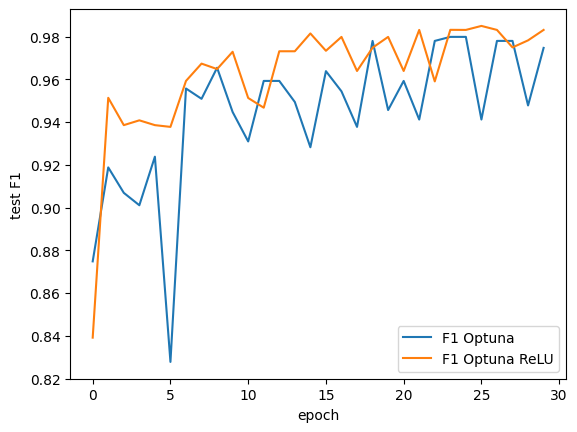

In [ ]:
#TEAM RL
#This code graphs the ReLU vs the CNN
sns.lineplot(x='epoch', y='test F1', data=cnn_optimal_results, label='F1 Optuna ')
sns.lineplot(x='epoch', y='test F1', data=cnn_optimal_ReLU_results, label='F1 Optuna ReLU')

In [ ]:
#TEAM RL
#This code gives details on the ReLU model
cnn_optimal_ReLU_results.tail()

,epoch,total time,train loss,test loss,train Acc,test Acc,train F1,test F1
25,25,6.204065,0.027265,0.038954,0.991206,0.985,0.991317,0.984970
26,26,6.445700,0.029200,0.054254,0.992462,0.980,0.992462,0.983099
27,27,6.641439,0.030370,0.087284,0.989950,0.970,0.989847,0.974919
28,28,6.825395,0.028705,0.069433,0.988693,0.975,0.988637,0.978220
29,29,7.030365,0.027595,0.064390,0.989950,0.980,0.989933,0.983099


#**Improve the CNN**

In [ ]:
#TEAM RL
#This code defines the dimensions of the CNN

H=30
W=43
D = H*W #30 days * 18 features images
#How many channels are in the input?
C = 1
#How many classes are there?
classes = 4
#How many filters should we use
n_filters = 20
#how large should our filters be?
K = 3
epochs = 30


eta_0 = 0.0014809916429001852
eta_min = 0.0014809916429001852/10 #Our desired final learning rate $\eta_{\mathit{min}}$

gamma_expo = (eta_min/eta_0)**(1/epochs)#compute $\gamma$ that results in $\eta_{\mathit{min}}$

In [ ]:
#TEAM RL
#This code defines the leak rate
leak_rate = 0.1 #How much I want the LeakyReLU to "leak" by. Anything in [0.01, 0.3] would have been fine.

In [ ]:
#TEAM RL
#This code defines the cnnLayer

def cnnLayer(in_filters, out_filters=None, kernel_size=3):
    """
    in_filters: how many channels are coming into the layer
    out_filters: how many channels this layer should learn / output, or `None` if we want to have the same number of channels as the input.
    kernel_size: how large the kernel should be
    """
    if out_filters is None:
        out_filters = in_filters #This is a common pattern, so lets automate it as a default if not asked
    padding=kernel_size//2 #padding to stay the same size
    return nn.Sequential( # Combine the layer and activation into a single unit
        nn.Conv2d(in_filters, out_filters, kernel_size, padding=padding),
        nn.LeakyReLU(leak_rate)
    )

In [ ]:
#TEAM RL
#This code sets the max pool function and the cnn relu max pool model
cnn_relu_opt_MaxPool = nn.Sequential(
    cnnLayer(C, n_filters), cnnLayer(n_filters), cnnLayer(n_filters),
    nn.MaxPool2d((2,2)),
    cnnLayer(n_filters, 2*n_filters), cnnLayer(2*n_filters), cnnLayer(2*n_filters),
    nn.MaxPool2d((2,2)),
    cnnLayer(2*n_filters, 4*n_filters), cnnLayer(4*n_filters),
    nn.Flatten(),
    nn.Linear(4*n_filters*(H//4)*(W//4), classes),
)
#Caption: This is our generic CNN code block. Ignoring the object name, this code block can be re-purposed for many different styles of CNN hidden layers by changing the definition of the cnnLayer function.

In [ ]:
#TEAM RL
#This code sets up and runs the cnn relu max pool model
loss_func = nn.CrossEntropyLoss()

optimizer = torch.optim.AdamW(cnn_relu_opt_MaxPool.parameters())
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma_expo)

cnn_relu_opt_MaxPool_results = train_network(cnn_relu_opt_MaxPool, loss_func, training_loader, test_loader=testing_loader,optimizer=optimizer, lr_schedule=scheduler, epochs=30, score_funcs={'Acc': accuracy_score,'F1': f1_score}, device=device)
del cnn_relu_opt_MaxPool

Epoch:   0%|          | 0/30 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/50 [00:00<?, ?it/s]

Testing:   0%|          | 0/200 [00:00<?, ?it/s]

<Axes: xlabel='epoch', ylabel='test Acc'>

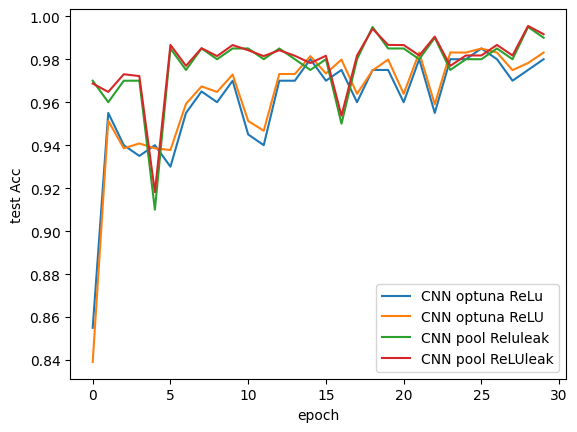

In [ ]:
#TEAM RL
#This code displays chargs of the different cnn relu and leakyrelu models

sns.lineplot(x='epoch', y='test Acc', data=cnn_optimal_ReLU_results, label='CNN optuna ReLu')
sns.lineplot(x='epoch', y='test F1', data=cnn_optimal_ReLU_results, label='CNN optuna ReLU')
sns.lineplot(x='epoch', y='test Acc', data=cnn_relu_opt_MaxPool_results, label='CNN pool Reluleak')
sns.lineplot(x='epoch', y='test F1', data=cnn_relu_opt_MaxPool_results, label='CNN pool ReLUleak')

<Axes: xlabel='epoch', ylabel='test Acc'>

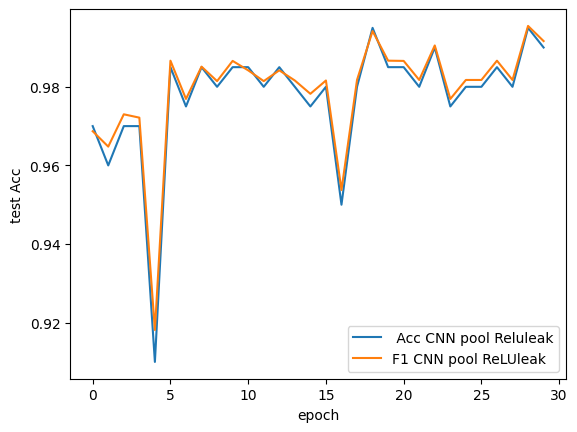

In [ ]:
#TEAM RL
#This code plots the CNN pool and ReLU Leak
sns.lineplot(x='epoch', y='test Acc', data=cnn_relu_opt_MaxPool_results, label=' Acc CNN pool Reluleak')
sns.lineplot(x='epoch', y='test F1', data=cnn_relu_opt_MaxPool_results, label='F1 CNN pool ReLUleak')

In [ ]:
#TEAM RL
#This code displays the detais of the CNN relu max pool
cnn_relu_opt_MaxPool_results.tail()

,epoch,total time,train loss,test loss,train Acc,test Acc,train F1,test F1
25,25,8.807555,0.015569,0.028819,0.992462,0.980,0.992495,0.981742
26,26,9.140236,0.018442,0.044599,0.992462,0.985,0.992495,0.986648
27,27,9.410333,0.023547,0.048751,0.991206,0.980,0.991263,0.981742
28,28,9.758967,0.014698,0.014070,0.996231,0.995,0.996256,0.995492
29,29,10.040505,0.013251,0.022630,0.994975,0.990,0.995018,0.991636
